In [1]:
#!pip install ipynb-path
import ipynb_path
import sys 
import os
__file__ = ipynb_path.get()
sys.path.append(os.path.abspath(os.path.join(os.path.dirname(__file__), '..','dbittools','Analysis','Python','read_dbit')))
import read_dbit
import numpy as np
import scanpy as sc
import squidpy as sq
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
datadir = os.path.abspath(os.path.join(os.path.dirname(__file__), '..','..','..','data','processed','A22-1650_ONH_01'))

In [3]:
# Must include a library_id name (for plotting below)
adata = read_dbit.read_dbit(path=datadir, count_file='count_file.tsv', library_id="ONH1650_1", load_images=True)
adata.uns['spatial']['ONH1650_1']['scalefactors']['tissue_lowres_scalef'] = 0.725
adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['spot_diameter_real_um'] = 25

/Users/mmd47/Dropbox/Yale/DiStasio Lab/OpticNerveHead_DBiT/data/processed/A22-1650_ONH_01/spatial/intersections_matx.txt
/Users/mmd47/Dropbox/Yale/DiStasio Lab/OpticNerveHead_DBiT/data/processed/A22-1650_ONH_01/spatial/tissue_positions_list.csv
None
Using intersections_matx.txt


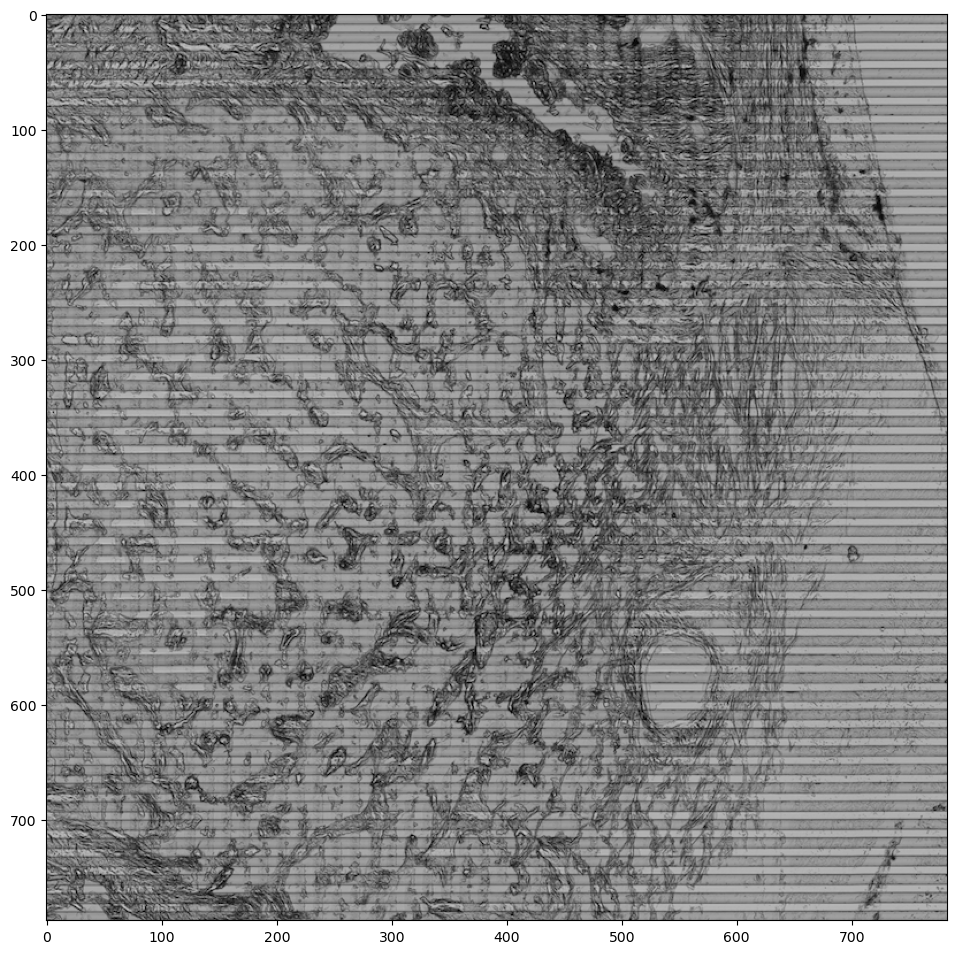

In [4]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 
plt.imshow(adata.uns['spatial']['ONH1650_1']['images']['lowres'])

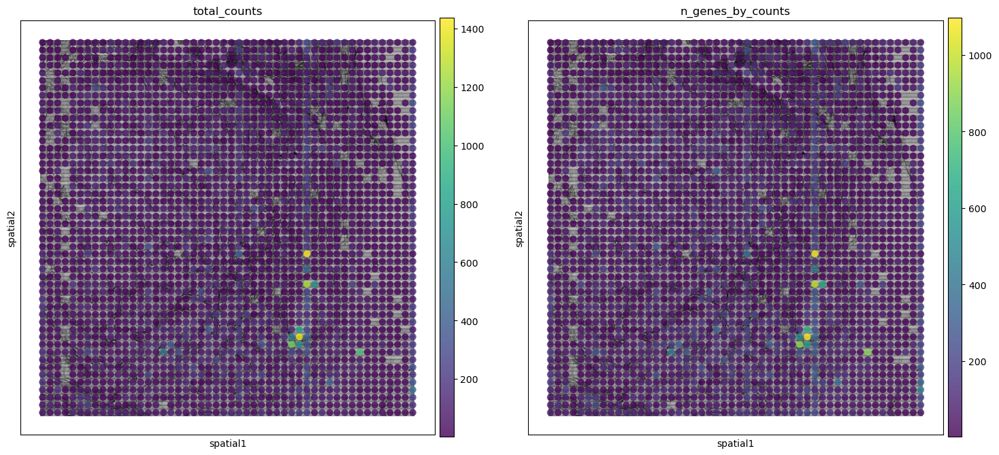

/Users/mmd47/miniconda3/envs/dbitseq/lib/python3.10/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='n_genes_by_counts'>

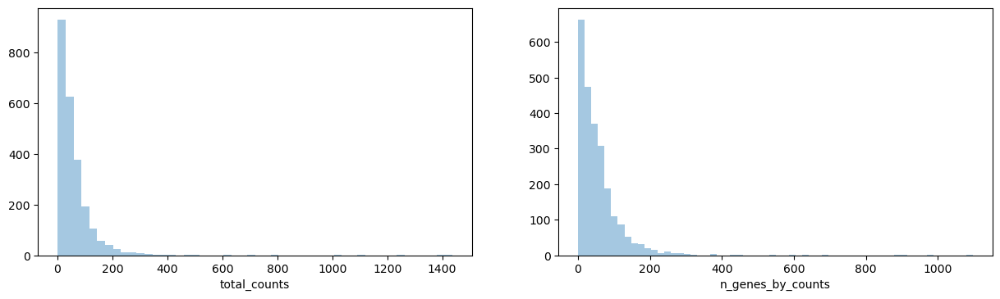

In [5]:

sc.pp.calculate_qc_metrics(adata, inplace=True)
plt.rcParams["figure.figsize"] = (8, 8)
# sc.pl.spatial(adata, img=adata.uns['spatial'][None]['images']['lowres'], 
#               color=["total_counts", "n_genes_by_counts"], spot_size=20, alpha=0.5, scale_factor=1.65)
sc.pl.spatial(adata, img_key="lowres", color=["total_counts", "n_genes_by_counts"], spot_size=20, alpha=0.8)

fig, axs = plt.subplots(1, 2, figsize=(15, 4))
sns.distplot(adata.obs["total_counts"], kde=False, ax=axs[0])
sns.distplot(adata.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[1])


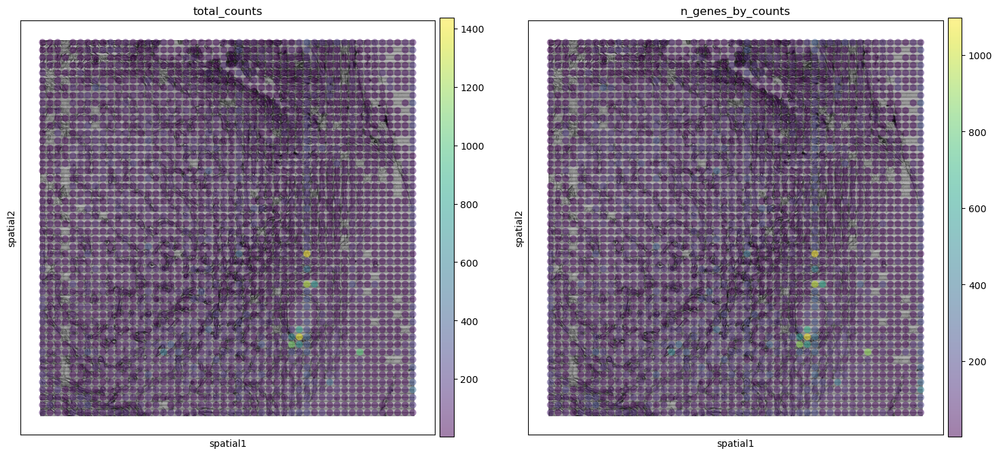

In [6]:
sc.pl.spatial(adata, img_key='lowres', color=["total_counts", "n_genes_by_counts"], spot_size=20, alpha=0.5)

In [45]:
sc.pp.filter_cells(adata, min_counts=20)
sc.pp.filter_cells(adata, max_counts=35000)
sc.pp.filter_genes(adata, min_cells=1)

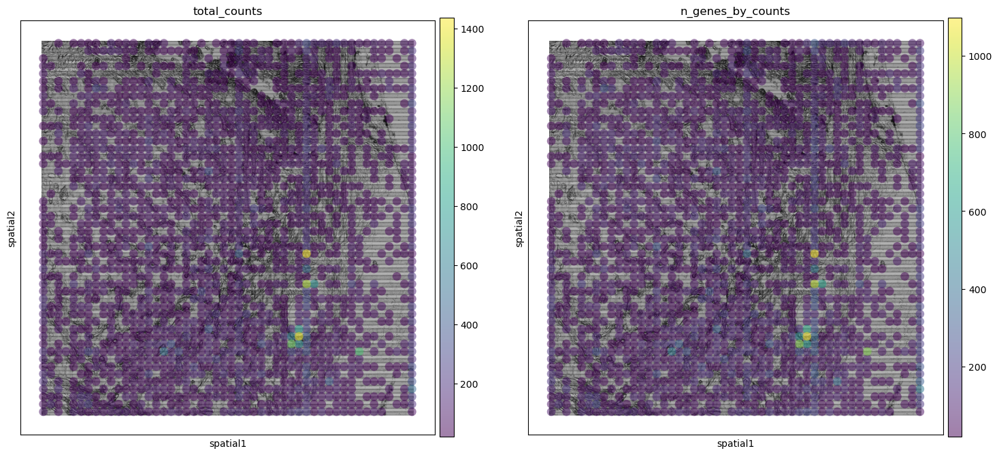

In [8]:
sc.pp.calculate_qc_metrics(adata, inplace=True)
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(adata, img_key="lowres", color=["total_counts", "n_genes_by_counts"], spot_size=25, alpha=0.5)

In [9]:
sc.pp.log1p(adata)

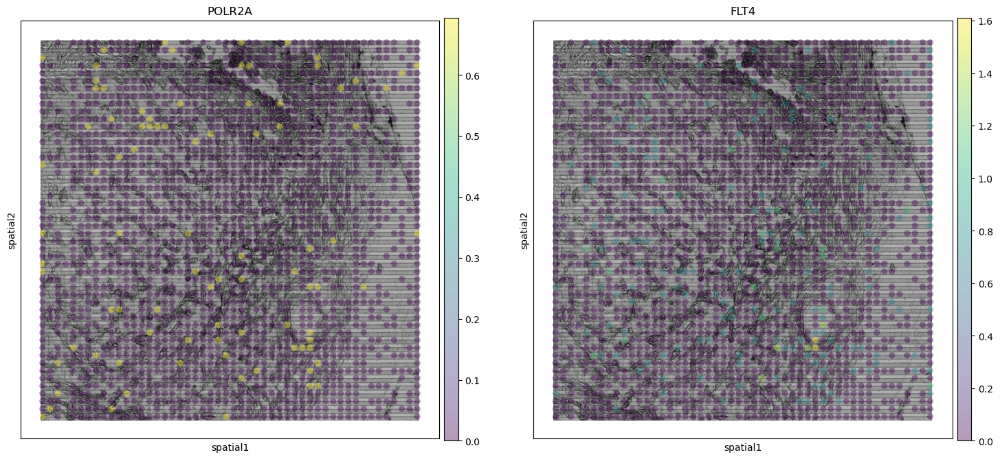

In [10]:
sc.pl.spatial(adata, img_key="lowres", color=["POLR2A","FLT4"], spot_size=18, alpha=0.4)

In [11]:
sc.pp.filter_cells(adata, min_counts=20)
sc.pp.filter_cells(adata, max_counts=35000)
sc.pp.filter_genes(adata, min_cells=1)

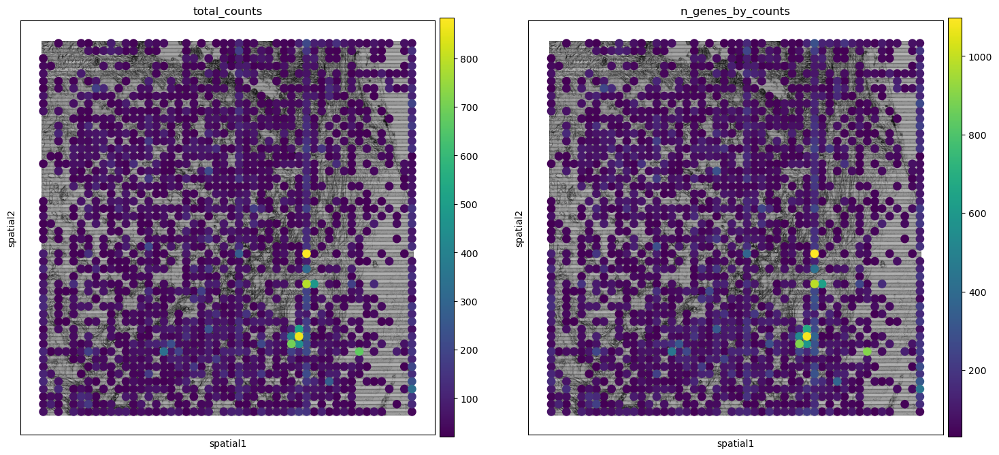

In [12]:
sc.pp.calculate_qc_metrics(adata, inplace=True)
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(adata, img_key="lowres", color=["total_counts", "n_genes_by_counts"], spot_size=25)

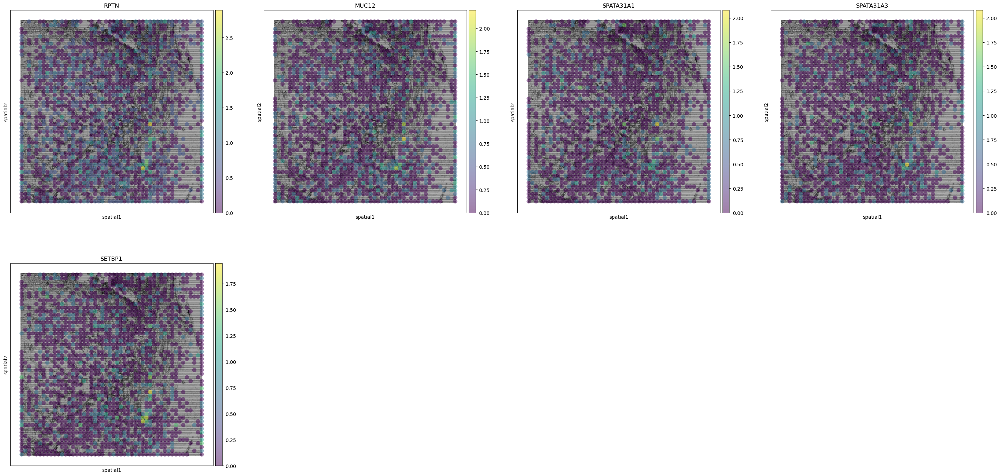

In [13]:
adata_filt = sc.pp.filter_genes(adata, min_counts=220, min_cells=None, max_counts=None, max_cells=None, inplace=False)
mygenes = adata.var_names[adata_filt[0]]
sc.pl.spatial(adata, img_key="lowres", color=mygenes, spot_size=25, alpha=0.5)

In [14]:

sc.pp.pca(adata)
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.tl.leiden(adata, key_added="clusters", resolution=0.8)

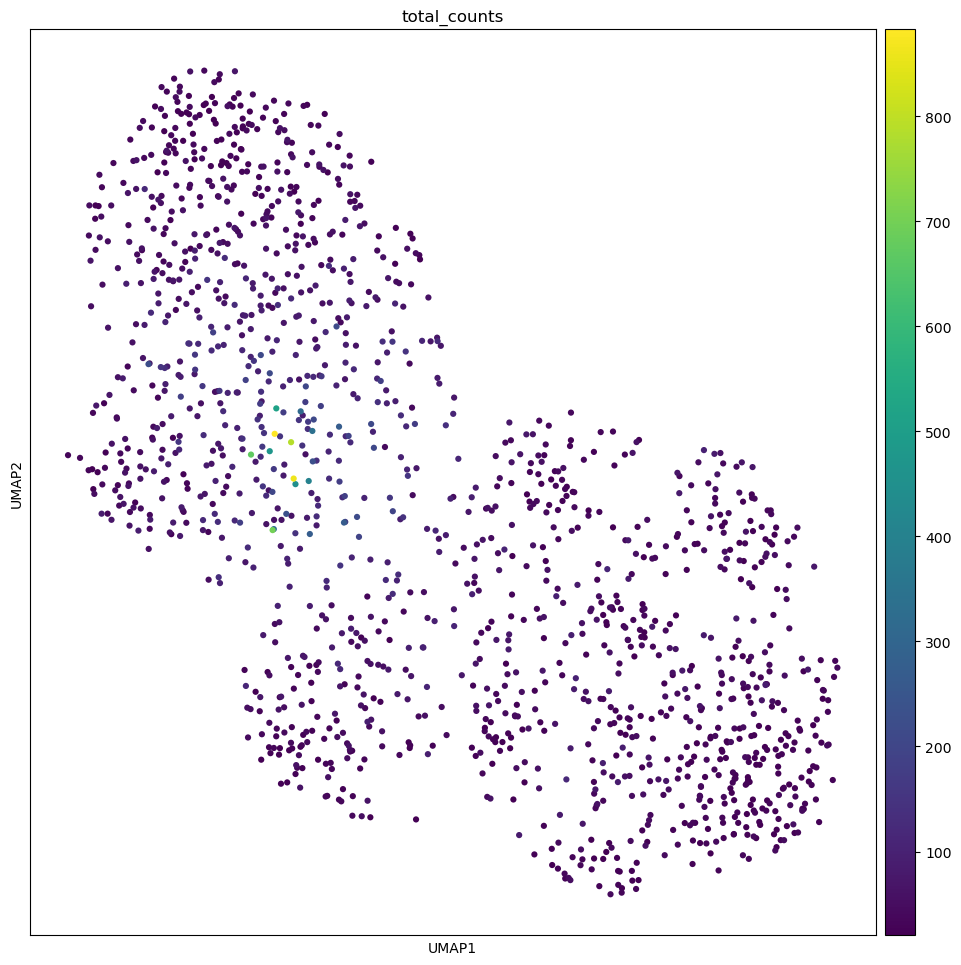

In [15]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 

#sc.pl.umap(adata, color=["total_counts", "n_genes_by_counts", "clusters"], wspace=0.4)
sc.pl.umap(adata, color=["total_counts"])

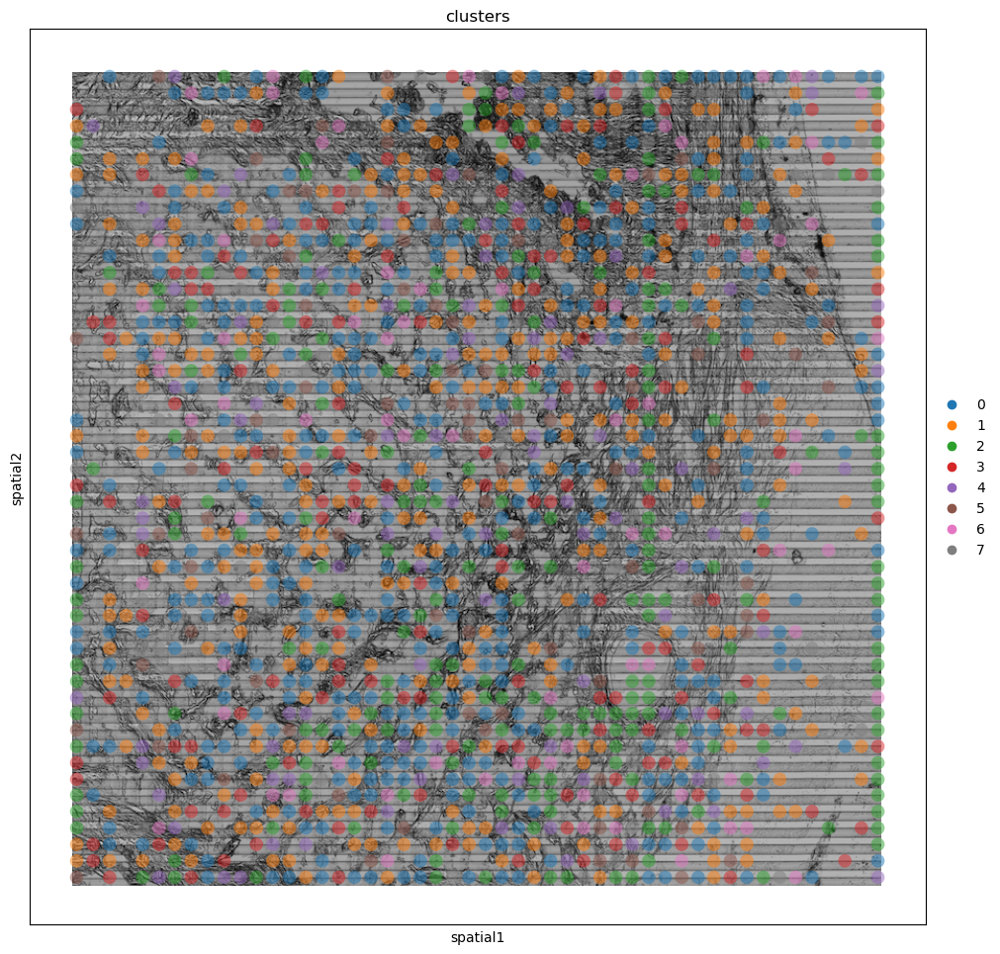

In [16]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 
sc.pl.spatial(adata, img_key="lowres", color="clusters", spot_size=18, alpha=0.5)

categories: 0, 1, 2, etc.
var_group_labels: Neuron, Other, T-cell


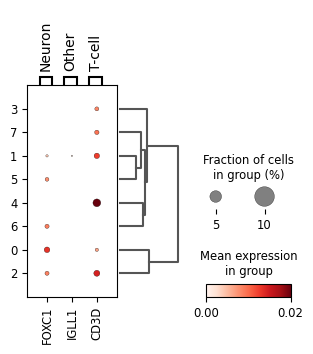

In [17]:
marker_genes_dict = {
    'Neuron': ['FOXC1'],
    'Other': ['IGLL1'],
    'T-cell': ['CD3D'],
}

sc.tl.dendrogram(adata, groupby='clusters')

sc.pl.dotplot(adata, marker_genes_dict, 'clusters', dendrogram=True)

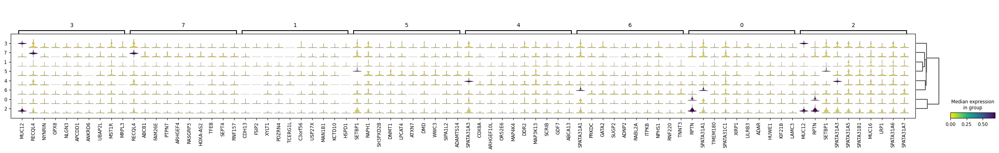

In [20]:

sc.tl.rank_genes_groups(adata, groupby='clusters', method='wilcoxon')
sc.pl.rank_genes_groups_stacked_violin(adata, n_genes=10, cmap='viridis_r')

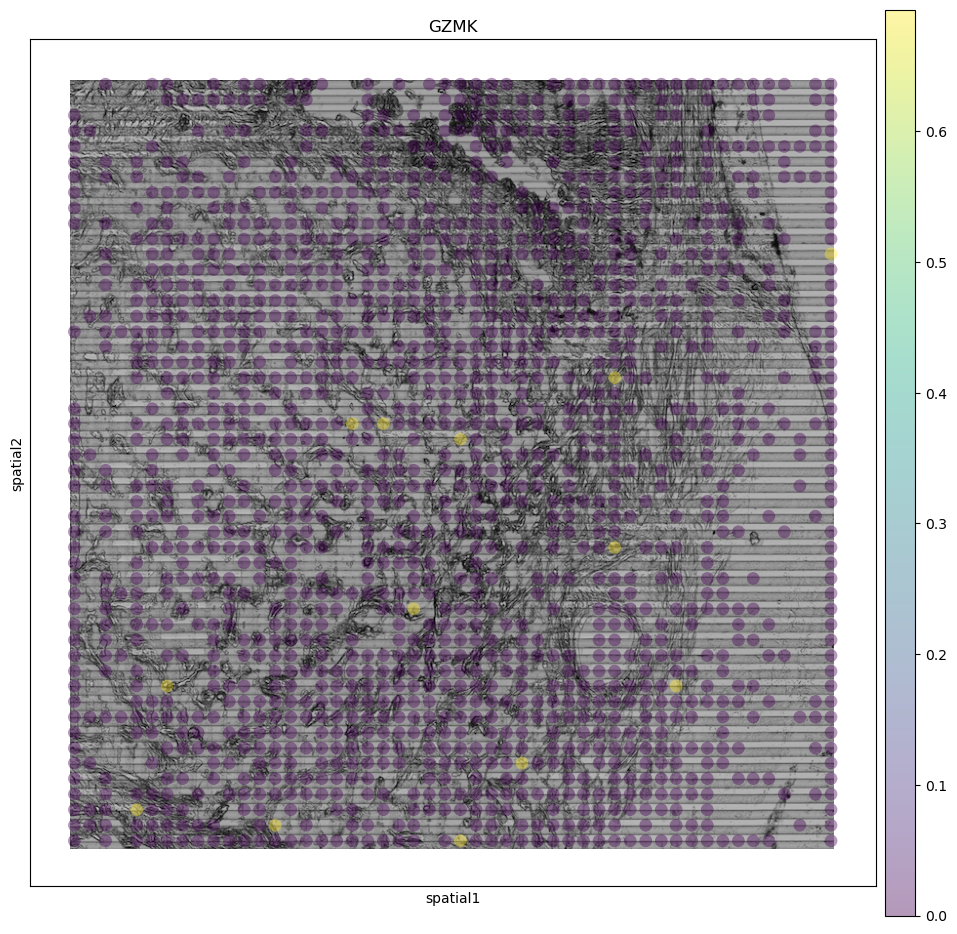

In [21]:
sc.pl.spatial(adata, img_key="lowres", color=["GZMK"], spot_size=18, alpha=0.4)

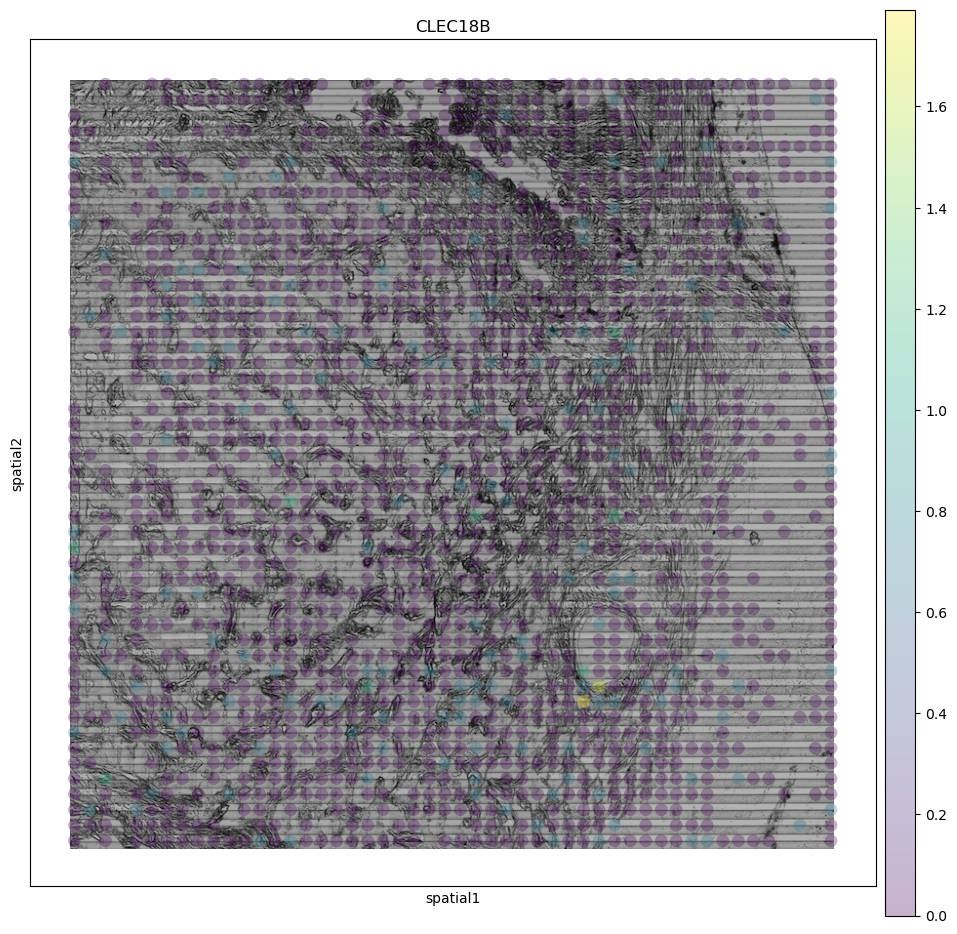

In [22]:
sc.pl.spatial(adata, img_key="lowres", color=["CLEC18B"], spot_size=18, alpha=0.3)

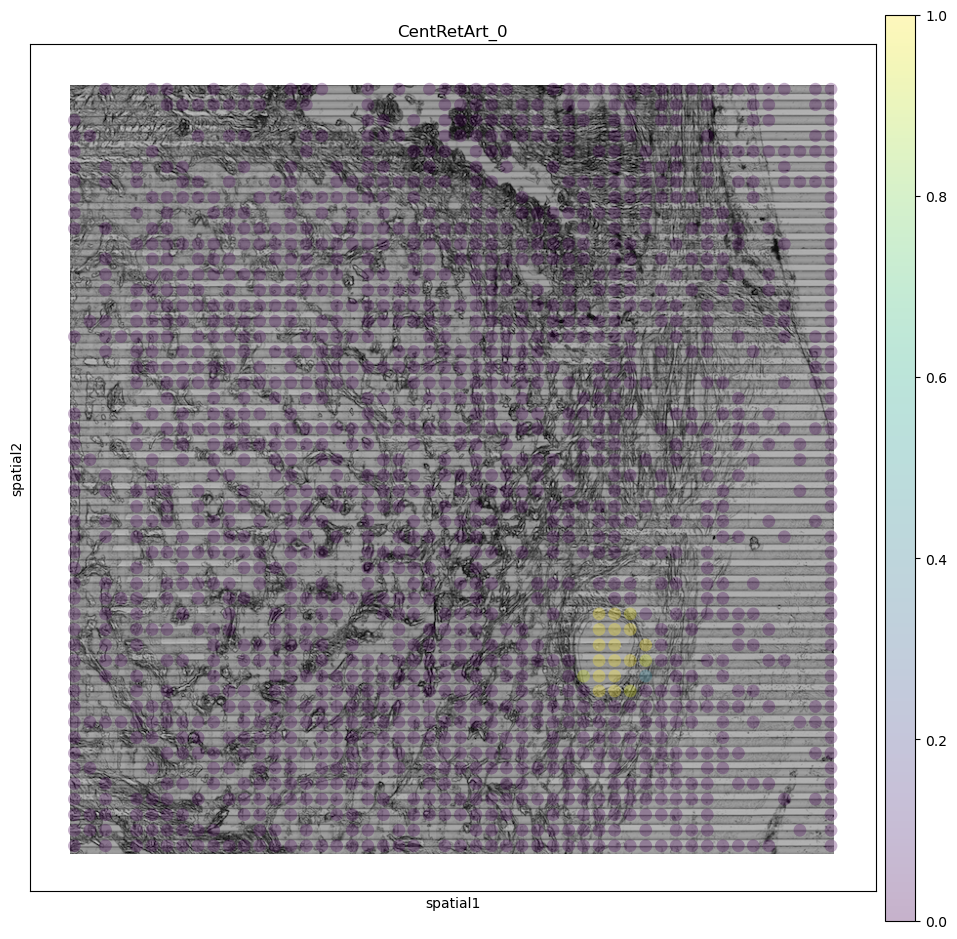

In [23]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 
sc.pl.spatial(adata, img_key="lowres", color=['CentRetArt_0'], spot_size=18, alpha=0.3)

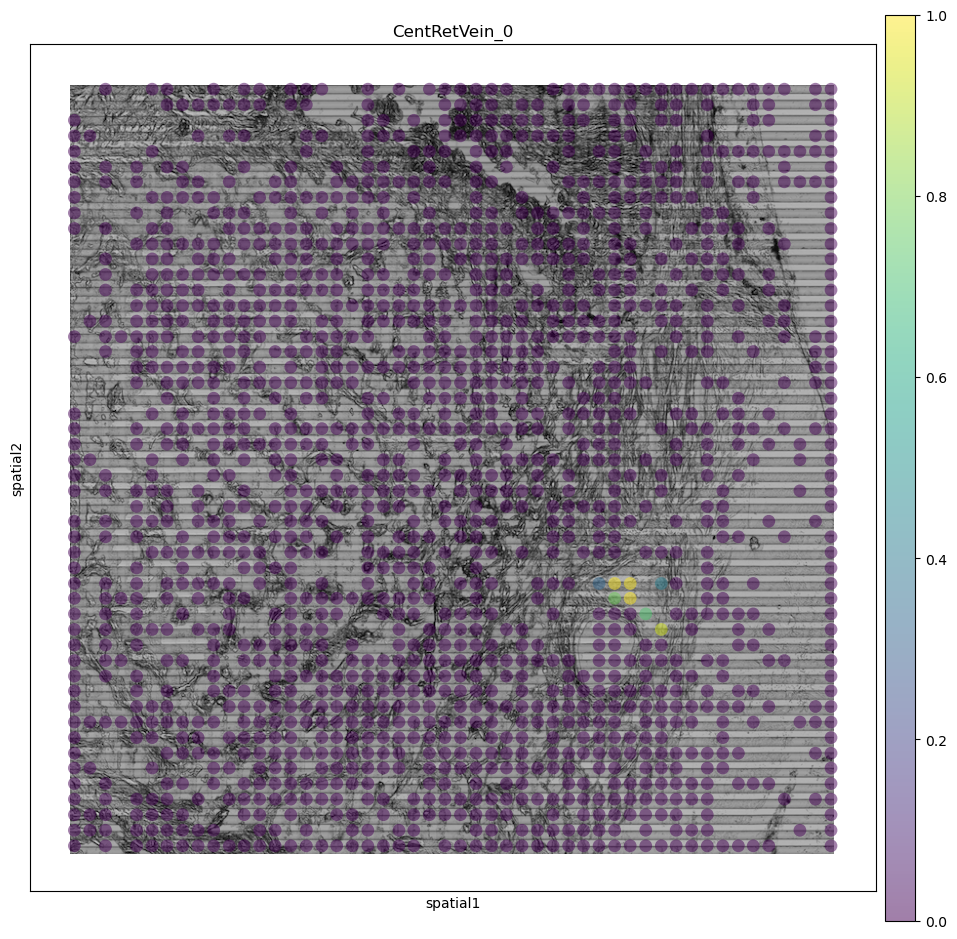

In [24]:
sc.pl.spatial(adata, img_key="lowres", color=['CentRetVein_0'], spot_size=18, alpha=0.5)

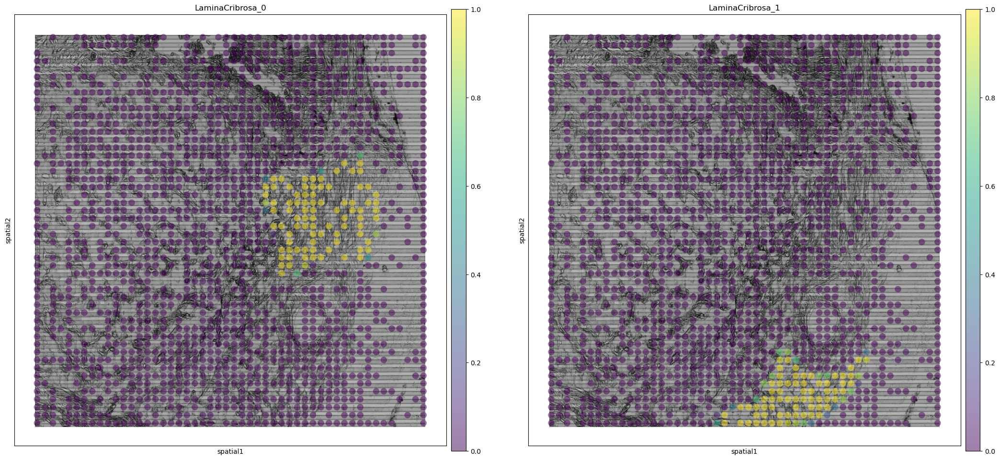

In [25]:
sc.pl.spatial(adata, img_key="lowres", color=['LaminaCribrosa_0','LaminaCribrosa_1'], spot_size=18, alpha=0.5)

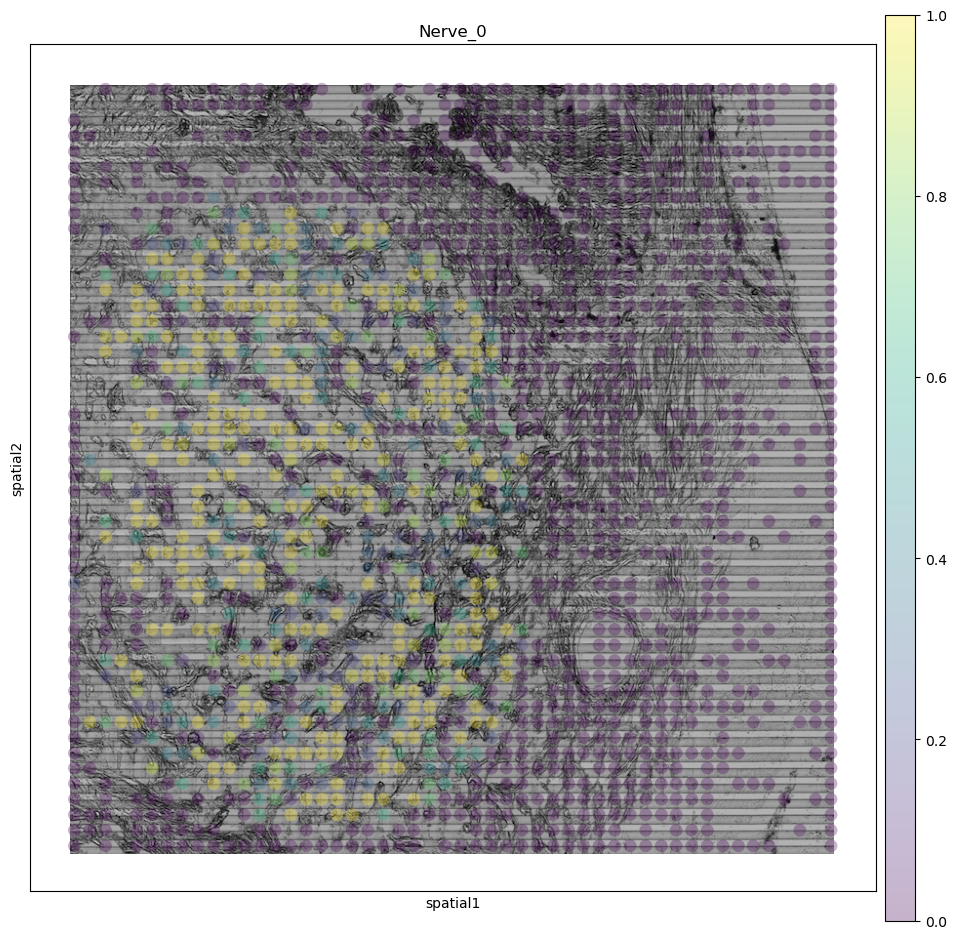

In [43]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 

sc.pl.spatial(adata, img_key="lowres", color=['Nerve_0'], spot_size=18, alpha=0.3)

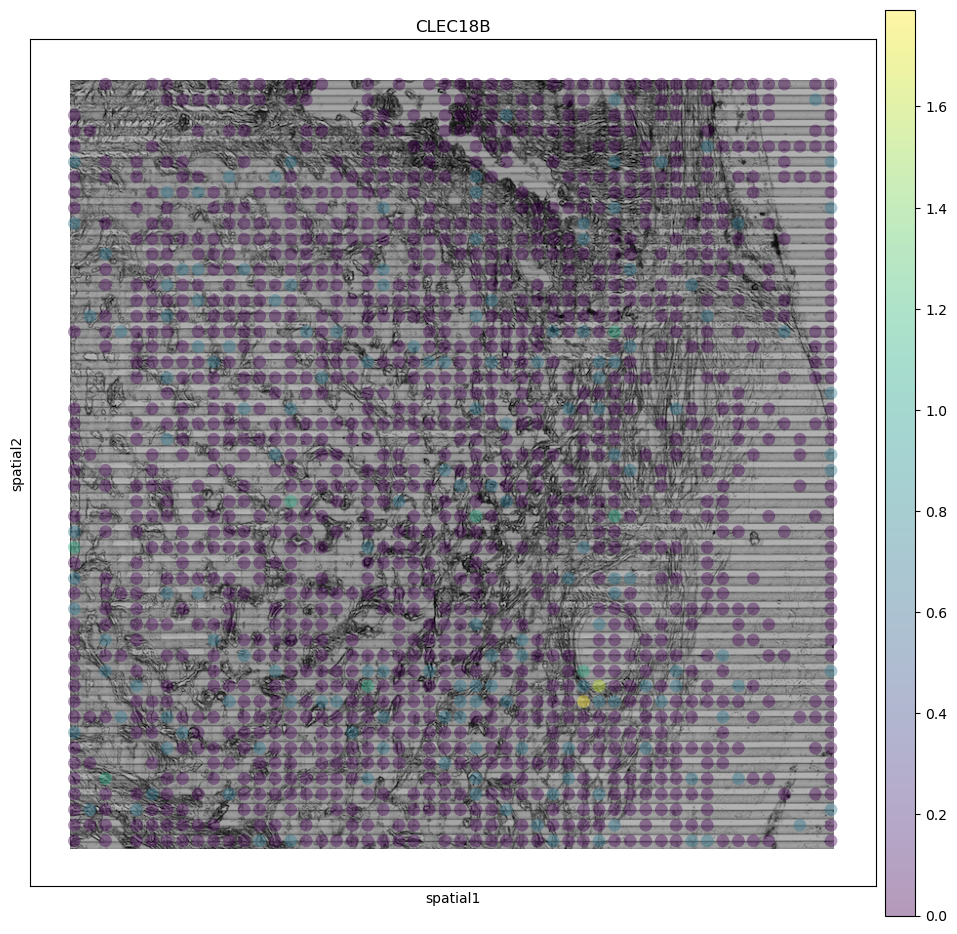

In [44]:
sc.pl.spatial(adata, img_key="lowres", color=["CLEC18B"], spot_size=18, alpha=0.4)

In [39]:
def normexprdensity(adata, genelist, regionname):
    if regionname in adata.obs_keys():
        spotdiam = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['spot_diameter_real_um']
        
        total_expression = adata[:,genelist].to_df().multiply(adata.obs[regionname], axis="index").sum()
        total_area = sum(adata.obs[regionname] * np.square(spotdiam)) 
        
        return (np.float32(total_expression/total_area)[0])

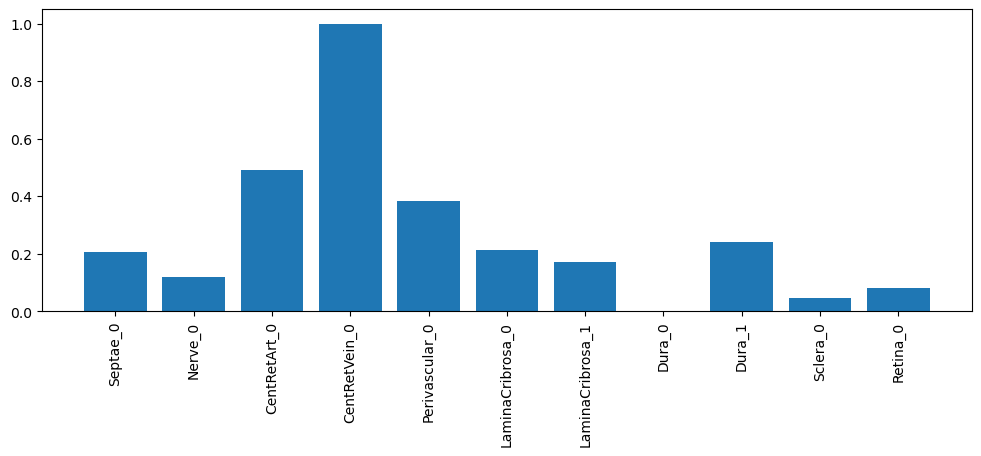

In [40]:
GENE_TO_PLOT = 'CLEC18B'   
    
Labels = []    
Values = []
for region in ['Septae_0',
 'Nerve_0',
 'CentRetArt_0',
 'CentRetVein_0',
 'Perivascular_0',
 'LaminaCribrosa_0',
 'LaminaCribrosa_1',
 'Dura_0',
 'Dura_1',
 'Sclera_0',
 'Retina_0',] :
        nd = normexprdensity(adata, [GENE_TO_PLOT], region)*100000
        Labels.append(region)
        Values.append(nd)

    
Values = (Values - np.min(Values))/(np.max(Values) - np.min(Values))
plt.rcParams['figure.figsize'] = [12, 4]
plt.rcParams['figure.dpi'] = 100 
plt.bar(np.arange(0,len(Labels),1), height=Values, tick_label=Labels)
plt.xticks(rotation='vertical')    
plt.show()

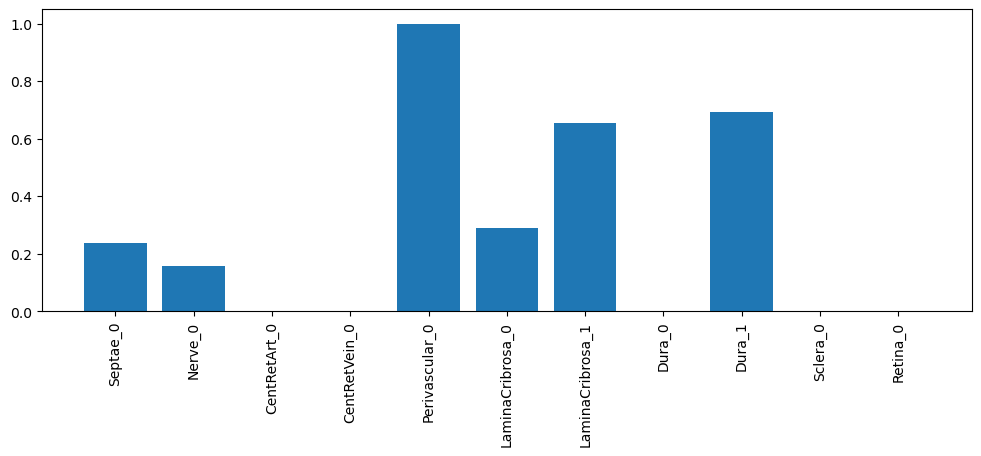

In [41]:
GENE_TO_PLOT = 'GZMK'   
    
Labels = []    
Values = []
for region in ['Septae_0',
 'Nerve_0',
 'CentRetArt_0',
 'CentRetVein_0',
 'Perivascular_0',
 'LaminaCribrosa_0',
 'LaminaCribrosa_1',
 'Dura_0',
 'Dura_1',
 'Sclera_0',
 'Retina_0',] :
        nd = normexprdensity(adata, [GENE_TO_PLOT], region)*100000
        Labels.append(region)
        Values.append(nd)

    
Values = (Values - np.min(Values))/(np.max(Values) - np.min(Values))
plt.rcParams['figure.figsize'] = [12, 4]
plt.rcParams['figure.dpi'] = 100 
plt.bar(np.arange(0,len(Labels),1), height=Values, tick_label=Labels)
plt.xticks(rotation='vertical')    
plt.show()

In [69]:
adata[adata.obs.query('n_counts > 20 and n_counts < 10 and n_genes_by_counts > 20').index]

View of AnnData object with n_obs × n_vars = 0 × 5162
    obs: 'Septae_0', 'Nerve_0', 'CentRetArt_0', 'CentRetVein_0', 'Perivascular_0', 'LaminaCribrosa_0', 'LaminaCribrosa_1', 'Dura_0', 'Dura_1', 'Sclera_0', 'Retina_0', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'n_counts', 'clusters'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'spatial', 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'clusters_colors', 'dendrogram_clusters', 'rank_genes_groups'
    obsm: 'spatial', 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'